## Preparacion de entorno

In [1]:
import sys
import matplotlib.pyplot as plt
import plotly.express as px

import numpy as np
import pandas as pd
import seaborn as sbn
import missingno as msno
from pandas_profiling import ProfileReport
from sklearn.preprocessing import OneHotEncoder
!pip install -q -U keras-tuner
!pip install pandas-profiling==2.7.1

!{sys.executable} -m pip install -U pandas-profiling[notebook]
! pip install pandas==0.25
%matplotlib inline
## Librerías generales
import numpy as np
import pandas as pd
from pandas.api.types import is_numeric_dtype

## Filtramos advertencias relacionadas con la convergencia de los algoritmos
import warnings
from sklearn.exceptions import ConvergenceWarning
warnings.filterwarnings('ignore', category=ConvergenceWarning)

## Clases y funciones útiles de scikit-learn
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, median_absolute_error

## Modelo neuronal:
## Multi-Layer Perceptron
from sklearn.neural_network import MLPRegressor

## Otros modelos para comparar con el modelo neuronal
from sklearn.ensemble import RandomForestRegressor

## Barras de progreso en los iteradores
from tqdm.notebook import tqdm

## Herramientas para graficar
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
sns.set_context('talk')
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
!pip install -q -U keras-tuner
import keras_tuner as kt


#Lectura dataframe 
url="https://drive.google.com/file/d/1VdP63KuqZULxvxbWD1zU31uc3amj95wZ/view?usp=sharing"
path = 'https://drive.google.com/uc?export=download&id=' + url.split('/')[-2]
df = pd.read_csv(path, sep=',')

  Using cached pandas-1.3.5-cp37-cp37m-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (11.3 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 0.25.0
    Uninstalling pandas-0.25.0:
      Successfully uninstalled pandas-0.25.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires pandas~=1.1.0; python_version >= "3.0", but you have pandas 1.3.5 which is incompatible.


  Using cached pandas-0.25.0-cp37-cp37m-manylinux1_x86_64.whl (10.4 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 1.3.5
    Uninstalling pandas-1.3.5:
      Successfully uninstalled pandas-1.3.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
xarray 0.18.2 requires pandas>=1.0, but you have pandas 0.25.0 which is incompatible.
visions 0.4.1 requires pandas>=0.25.3, but you have pandas 0.25.0 which is incompatible.
phik 0.12.0 requires pandas>=0.25.1, but you have pandas 0.25.0 which is incompatible.
pandas-profiling 2.7.1 requires pandas!=1.0.0,!=1.0.1,!=1.0.2,>=0.25.3, but you have pandas 0.25.0 which is incompatible.
google-colab 1.0.0 requires pandas~=1.1.0; python_version >= "3.0", but you have pandas 0.25.0 which is incompatible.
fbprophet 0.7.1 requires pandas>=1.0.4, but you have pandas 0.25.0 which is incompatible.


In [2]:
def display_metrics_test_train_rmse(metrics, set_ylim1, set_ylim2):
    fig, axes = plt.subplots(figsize=(16, 6), ncols=2)
    for hyperparm_value, hyperparm_metrics in metrics.items():
        for j, (metric_name, metric_values) in enumerate(hyperparm_metrics.items()):
            ax = axes[j]
            ax.set_ylabel(metric_name)
            x_plot = epochs
            y_plot = metric_values
            ax.plot(x_plot, y_plot, label=f'{hyperparm_value:f}')

    for ax in axes:
        ax.set_xlabel('Época')

    legend = axes[0].legend()
    legend.set_title('Learning Rate')
    
    if set_ylim1:
        axes[0].set_ylim(*set_ylim1)
    if set_ylim2:
        axes[1].set_ylim(*set_ylim2)

    plt.tight_layout()
    plt.show()

## Analisis Exploratorio

Comenzamos visualizando la base de datos

In [3]:
df_ml = df
df_ml.head()


,id,antig,m2total,m2cub,ambientes,banios,direccion,barrio,comuna,latitud,longitud,precioUSD,m2precioUSD,comisaria_dista,obelisco_dista,nrobos,sup_espacio_verde,count_gastronomia,count_culturales
0,1,0,200,200,0,0,Gral Paz y Rivadavia,LINIERS,9,-34.639300,-58.528647,1500000,7500.000000,1162.621600,14053.797191,134,68426.445,12,0
1,2,30,50,50,0,1,Asuncion,VILLA DEVOTO,11,-34.611807,-58.528138,125000,2500.000000,1887.227055,13473.139375,23,110997.543,3,0
2,3,30,414,414,0,2,Avenida Beiro 5574,VILLA REAL,10,-34.616468,-58.528111,590000,1425.120773,1497.020434,13514.662463,33,115341.039,5,0
3,4,35,414,414,0,2,Avenida Beiro 5574,VILLA REAL,10,-34.616344,-58.527918,730000,1763.000000,1506.066814,13495.631683,33,115500.289,5,0
4,5,35,285,285,0,1,Avenida Beiro 5574,VILLA REAL,10,-34.616344,-58.527918,550000,1929.000000,1506.066814,13495.631683,33,115500.289,5,0


Revisamos la variable 'barrio', viendo sus valores únicos para detectar posibles errores. Esta es la única variable con caracteres alfabéticos.
Al encontrar un problema en el encoding de la letra ñ, lo solucionamos reemplazando "Nuñez" por "Nunez"

In [4]:
df_ml['barrio'].unique()

array(['LINIERS', 'VILLA DEVOTO', 'VILLA REAL', 'VERSALLES', 'MATADEROS',
       'MONTE CASTRO', 'VILLA LURO', 'VILLA PUEYRREDON', 'VILLA URQUIZA',
       'AGRONOMIA', 'VELEZ SARSFIELD', 'VILLA DEL PARQUE', 'VILLA LUGANO',
       'SAAVEDRA', 'FLORESTA', 'VILLA SANTA RITA', 'PARQUE AVELLANEDA',
       'PARQUE CHAS', 'VILLA RIACHUELO', 'COGHLAN', 'PATERNAL',
       'VILLA ORTUZAR', 'VILLA GRAL. MITRE', 'FLORES', 'NU�EZ',
       'BELGRANO', 'CHACARITA', 'CABALLITO', 'COLEGIALES', 'VILLA CRESPO',
       'PARQUE CHACABUCO', 'PALERMO', 'VILLA SOLDATI', 'ALMAGRO',
       'NUEVA POMPEYA', 'BOEDO', 'RECOLETA', 'BALVANERA', 'SAN CRISTOBAL',
       'PARQUE PATRICIOS', 'SAN NICOLAS', 'MONTSERRAT', 'CONSTITUCION',
       'RETIRO', 'BARRACAS', 'SAN TELMO', 'BOCA', 'PUERTO MADERO'],
      dtype=object)

In [5]:
indexes = df.barrio == "NU�EZ"
df_ml.loc[indexes, ['barrio']] = 'NUNEZ'

Usamos ProfileReport de keras para realizar una exploración de todas las variables, observamos mínimos, máximos, histogramas y mas. 

In [6]:
profile = ProfileReport(df_ml)


In [7]:
profile

Summarize dataset:   0%|          | 0/31 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Algunos *gráficos*

In [9]:
# Cuantos barrios y cuantas comunas hay?

q_barrios=df_ml['barrio'].nunique()
q_comunas=df_ml['comuna'].nunique()

print(f'Cantidad de barrios: {q_barrios}')
print(f'Cantidad de comunas: {q_comunas}')

Cantidad de barrios: 48
Cantidad de comunas: 15


In [10]:
comunas_count = df_ml.groupby(['barrio']).count()
df_comunas_count = pd.DataFrame(comunas_count)
df_comunas_count["barrio"] = df_comunas_count.index
df_comunas_count.reset_index

df_comunas_count = df_comunas_count.sort_values('id', ascending=False)


fig = px.bar(df_comunas_count,
             x=     'barrio',
             y=      'id'
             )
fig.show()


In [11]:
# Cuantos locales comerciales hay por barrio?

df_ml.groupby(['barrio']).size()
df_ml.barrio.value_counts()

PALERMO              438
SAN NICOLAS          351
BALVANERA            310
VILLA CRESPO         305
RECOLETA             239
ALMAGRO              179
RETIRO               176
MONTSERRAT           166
BELGRANO             127
FLORES               122
CABALLITO             93
VILLA URQUIZA         82
SAN TELMO             80
CONSTITUCION          63
BARRACAS              61
CHACARITA             56
PARQUE PATRICIOS      53
LINIERS               43
COLEGIALES            43
SAAVEDRA              42
BOEDO                 42
VILLA GRAL. MITRE     42
SAN CRISTOBAL         42
MATADEROS             40
PARQUE CHACABUCO      39
NUNEZ                 37
VILLA DEVOTO          33
VILLA ORTUZAR         30
VILLA DEL PARQUE      30
VELEZ SARSFIELD       29
VILLA SANTA RITA      28
FLORESTA              28
PATERNAL              27
NUEVA POMPEYA         25
PUERTO MADERO         25
PARQUE AVELLANEDA     23
COGHLAN               21
MONTE CASTRO          21
PARQUE CHAS           21
BOCA                  19


comuna
1     559952.319396
14    479622.694064
2     438113.179916
15    412467.803532
12    386208.844720
3     383917.573864
13    376808.454106
9     339734.264151
5     323143.171946
4     322149.367089
8     299200.000000
6     298061.290323
7     279002.142857
11    265175.180451
10    253029.111111
Name: precioUSD, dtype: float64AxesSubplot(0.125,0.125;0.775x0.755)


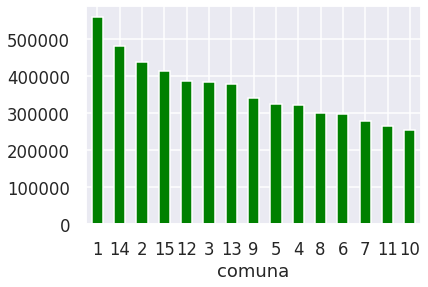

In [12]:
# Cual es el precio promedio por comuna?

print(df_ml.groupby(['comuna'])['precioUSD'].mean().sort_values(ascending=False),end=""),
print(df_ml.groupby(['comuna'])['precioUSD'].mean().sort_values(ascending=False).plot(kind='bar',rot=0,color={"green"}))

In [13]:
# Cual es la comuna con mayor y menor precio promedio?

comunas = df_ml.groupby(['comuna']).mean()
df_comunas = pd.DataFrame(comunas)

print(df_comunas['precioUSD'][df_comunas['precioUSD'] == df_comunas["precioUSD"].max()])
print(df_comunas['precioUSD'][df_comunas['precioUSD'] == df_comunas["precioUSD"].min()])

comuna
1    559952.319396
Name: precioUSD, dtype: float64
comuna
10    253029.111111
Name: precioUSD, dtype: float64


barrio
PUERTO MADERO        1.397392e+06
SAN NICOLAS          6.190611e+05
COGHLAN              5.838238e+05
BOEDO                5.758786e+05
RETIRO               5.157338e+05
SAN TELMO            5.064560e+05
MONTSERRAT           5.035633e+05
VILLA RIACHUELO      5.012800e+05
VILLA CRESPO         4.885817e+05
PALERMO              4.796227e+05
RECOLETA             4.381132e+05
SAAVEDRA             4.208690e+05
VILLA REAL           4.095833e+05
BALVANERA            4.066552e+05
LINIERS              4.008263e+05
BELGRANO             3.853179e+05
NUNEZ                3.821507e+05
MATADEROS            3.748475e+05
PARQUE PATRICIOS     3.651792e+05
VILLA URQUIZA        3.619491e+05
COLEGIALES           3.470791e+05
NUEVA POMPEYA        3.356800e+05
BARRACAS             3.348131e+05
VILLA DEL PARQUE     3.261066e+05
VERSALLES            3.191667e+05
FLORES               3.086090e+05
CABALLITO            2.980613e+05
VILLA DEVOTO         2.948485e+05
VILLA SANTA RITA     2.798500e+05
CHACARI

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47]),
 <a list of 48 Text major ticklabel objects>)

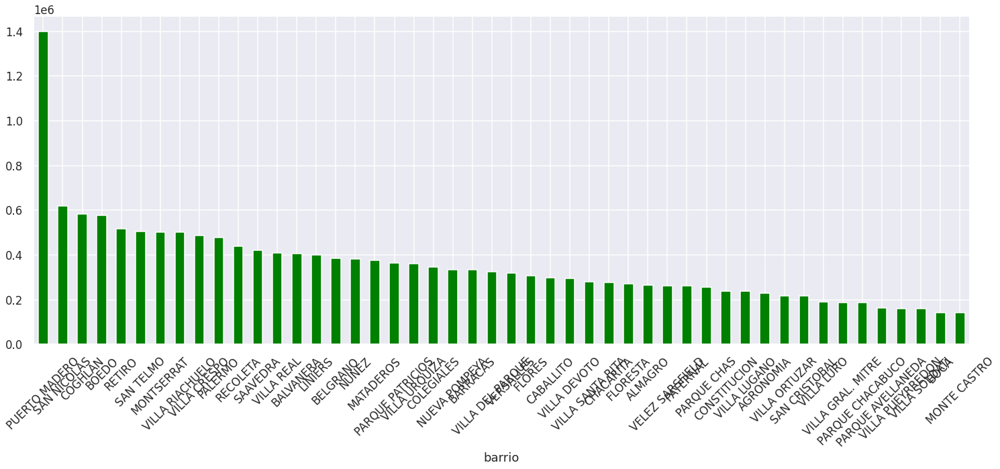

In [14]:
# Cual es el precio promedio por barrio?

print(df_ml.groupby(['barrio'])['precioUSD'].mean().sort_values(ascending=False),end=""),
print(df_ml.groupby(['barrio'])['precioUSD'].mean().sort_values(ascending=False).plot(kind='bar',rot=0,color={"green"},figsize=(25
                                                                                                                              ,9)))
plt.xticks(rotation=45)

In [15]:
# Cual es el barrio con mayor y menor precio promedio?

barrios = df_ml.groupby(['barrio']).mean()
df_barrios = pd.DataFrame(barrios)

print(df_barrios['precioUSD'][df_barrios['precioUSD'] == df_barrios["precioUSD"].max()])
print(df_barrios['precioUSD'][df_barrios['precioUSD'] == df_barrios["precioUSD"].min()])



barrio
PUERTO MADERO    1397391.6
Name: precioUSD, dtype: float64
barrio
MONTE CASTRO    142019.047619
Name: precioUSD, dtype: float64


In [16]:
# Cual es la antiguedad promedio general y de las propiedades por barrio?

antig_promedio = df_ml['antig'].mean()


print(f'La antiguedad general promedio es: {round(antig_promedio,2)}\n')
print(f"{df_ml.groupby(['barrio'])['antig'].mean()}\n")
print(f"{df_ml.groupby(['comuna'])['antig'].mean()}\n")

La antiguedad general promedio es: 14.05

barrio
AGRONOMIA             2.142857
ALMAGRO              18.893855
BALVANERA            17.467742
BARRACAS              9.229508
BELGRANO              8.464567
BOCA                 17.526316
BOEDO                11.880952
CABALLITO             9.838710
CHACARITA            10.267857
COGHLAN              10.904762
COLEGIALES           14.883721
CONSTITUCION         17.349206
FLORES               14.295082
FLORESTA             11.678571
LINIERS              17.581395
MATADEROS            16.300000
MONTE CASTRO         13.619048
MONTSERRAT           21.981928
NUEVA POMPEYA        10.000000
NUNEZ                12.486486
PALERMO              12.326484
PARQUE AVELLANEDA    18.565217
PARQUE CHACABUCO     10.974359
PARQUE CHAS           9.333333
PARQUE PATRICIOS      5.792453
PATERNAL             14.814815
PUERTO MADERO         2.200000
RECOLETA             12.271967
RETIRO               15.846591
SAAVEDRA             11.761905
SAN CRISTOBAL        

comuna
5     63
2     63
6     52
3     48
14    31
11    21
10    20
12    17
7     17
13    16
8     10
15     9
9      9
4      9
1      2
Name: nrobos, dtype: int64AxesSubplot(0.125,0.125;0.775x0.755)


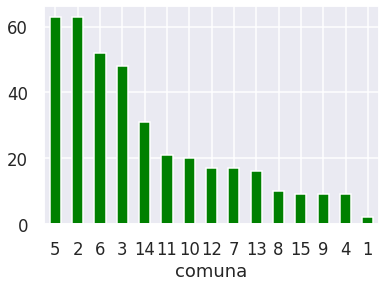

In [17]:
# Cual es el nro de robos mayor por comuna?

print(df_ml.groupby(['comuna'])['nrobos'].min().sort_values(ascending=False),end=""),
print(df_ml.groupby(['comuna'])['nrobos'].min().sort_values(ascending=False).plot(kind='bar',rot=0,color={"green"}))

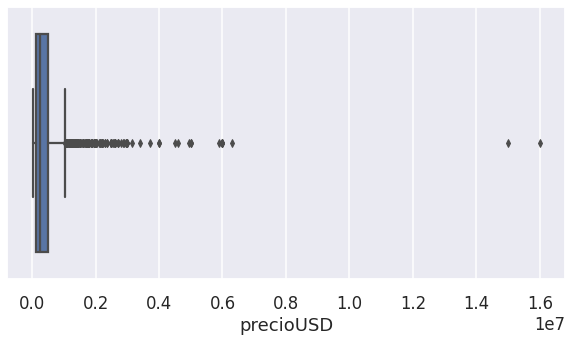

In [18]:
# Veamos si hay outliers en el precio

plt.figure(figsize=(10,5))
sns.boxplot(data = df_ml, x = 'precioUSD')
plt.show()

In [19]:
# Observamos que hay dos valores atípicos

df_ml[df_ml['precioUSD'] > 7500000]

,id,antig,m2total,m2cub,ambientes,banios,direccion,barrio,comuna,latitud,longitud,precioUSD,m2precioUSD,comisaria_dista,obelisco_dista,nrobos,sup_espacio_verde,count_gastronomia,count_culturales
1928,1929,0,14400,14400,0,1,San Juan Av. al 3300,BOEDO,5,-34.625180,-58.412626,16000000,1111.0,867.110693,3713.248880,71,16946.578,4,5
3211,3212,50,2600,2600,0,4,Reconquista al 100,SAN NICOLAS,1,-34.603274,-58.374548,15000000,5769.0,193.172835,646.200929,239,170829.169,207,27


In [20]:
# Los eliminamos para disminuir la variabilidad

df_ml = df_ml[df_ml['precioUSD'] < 7500000]

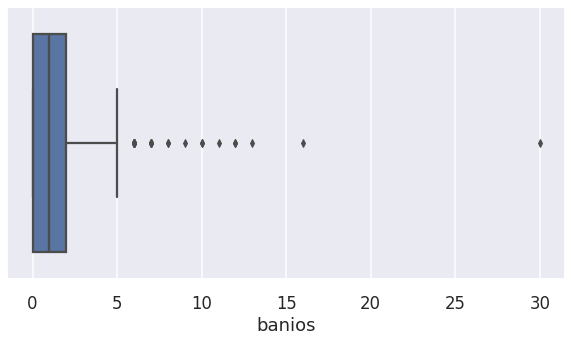

In [21]:
# Veamos si hay outliers en el precio

plt.figure(figsize=(10,5))
sns.boxplot(data = df_ml, x = 'banios')
plt.show()

In [22]:
# Observamos que hay un valor atípicos pero tiene una superficie que hace sospechar que es un shopping

df_ml[df_ml['banios'] > 20]

,id,antig,m2total,m2cub,ambientes,banios,direccion,barrio,comuna,latitud,longitud,precioUSD,m2precioUSD,comisaria_dista,obelisco_dista,nrobos,sup_espacio_verde,count_gastronomia,count_culturales
2008,2009,0,500,500,0,30,Urquiza al 200,BALVANERA,3,-34.61261,-58.409994,1200000,2400.0,497.719414,2787.794732,164,23887.376,33,4


In [23]:
# Lo eliminamos para disminuir la variabilidad

df_ml = df_ml[df_ml['banios'] < 7500000]

Dejamos de lado las variables:
'id', 'direccion', 'latitud' y 'longitud'. Estas variables no nos aportan informacion significativa para el uso de modelos predictivos.

Tambien removemos la columna m2precioUSD ya que está directamente relacionada con nuestra variable objetivo: precioUSD

In [24]:
df_ml = df.copy().drop(['id', 'direccion', 'latitud', 'longitud', 'm2precioUSD'], axis=1)
orig_columns = df_ml.columns

Convertimos la columna 'barrio' a one-hot encoding, dado que es una variable categórica, luego eliminamos la columna original del dataset.
Hacemos lo mismo para las columna 'Comuna', ya que por mas que sea númerica, es una variable categórica cualitativa.

In [25]:
onehot_encoder = OneHotEncoder(sparse= False)
barrio_dummies_df = pd.DataFrame(
    onehot_encoder.fit_transform(df_ml['barrio'].to_numpy().reshape(-1, 1)), 
    columns=['AGRONOMIA', 'ALMAGRO', 'BALVANERA', 'BARRACAS', 'BELGRANO', 'BOCA', 'BOEDO', 'CABALLITO', 'CHACARITA', 'COGHLAN', 'COLEGIALES', 'CONSTITUCION', 'FLORES', 'FLORESTA', 'LINIERS', 'MATADEROS', 'MONTE CASTRO', 'MONTSERRAT', 'NUEVA POMPEYA', 'NUNEZ', 'PALERMO', 'PARQUE AVELLANEDA', 'PARQUE CHACABUCO', 'PARQUE CHAS', 'PARQUE PATRICIOS', 'PATERNAL', 'PUERTO MADERO', 'RECOLETA', 'RETIRO', 'SAAVEDRA', 'SAN CRISTOBAL', 'SAN NICOLAS', 'SAN TELMO', 'VELEZ SARSFIELD', 'VERSALLES', 'VILLA CRESPO', 'VILLA DEL PARQUE', 'VILLA DEVOTO', 'VILLA GRAL. MITRE', 'VILLA LUGANO', 'VILLA LURO', 'VILLA ORTUZAR', 'VILLA PUEYRREDON', 'VILLA REAL', 'VILLA RIACHUELO', 'VILLA SANTA RITA', 'VILLA SOLDATI', 'VILLA URQUIZA']
)

df_ml = pd.concat([barrio_dummies_df, df_ml], axis=1).drop(['barrio'], axis=1)

In [26]:
onehot_encoder = OneHotEncoder(sparse= False)
comuna_dummies_df = pd.DataFrame(
    onehot_encoder.fit_transform(df_ml['comuna'].to_numpy().reshape(-1, 1)), 
    columns=["COMUNA_{}".format(i) for i in range(0, 15)]
)
df_ml = pd.concat([comuna_dummies_df, df_ml], axis=1).drop(['comuna'], axis=1)

Para finalizar con el preprocesado de los datos, definimos como variable objetivo 'precioUSD', y separamos el conjunto de datos en X, Y. 
Luego separamos el conjunto de datos en un conjunto de entrenamiento (80%) y uno de testeo (20%)

In [27]:
test_size = 0.20
TARGET_COL = 'precioUSD'
X = df_ml.drop(columns=[TARGET_COL])
y = df_ml[TARGET_COL]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=22)

## MLPRegressor

Comenzamos entrenando un regresor linear múltiple con todas las variables preseleccionadas.

In [28]:
model_MLP = MLPRegressor(random_state=1, max_iter=500).fit(X_train, y_train)

In [29]:
print("Con este modelo obtenemos un R^2 = ", model_MLP.score(X_test, y_test))

Con este modelo obtenemos un R^2 =  0.49255366221542296


In [30]:

pred_train = model_MLP.predict(X_train)
pred_test  = model_MLP.predict(X_test)

print('Train RMSE = {:.0f}'.format(np.sqrt(mean_squared_error(pred_train, y_train))))
print('Test  RMSE = {:.0f}'.format(np.sqrt(mean_squared_error(pred_test, y_test))))

Train RMSE = 424204
Test  RMSE = 356740


Luego comprobaremos que usar variables normalizadas nos otorga mejores resultados al entrenar el modelo.

In [31]:

scaler_X_train = StandardScaler()
scaler_X_test = StandardScaler()
scaler_y_train = StandardScaler()
scaler_y_test = StandardScaler()

scaler_X_train.fit(X_train)
X_scaled_train = scaler_X_train.transform(X_train)

scaler_X_test.fit(X_test)
X_scaled_test  = scaler_X_test.transform(X_test)

scaler_y_train.fit(y_train.values.reshape(-1, 1))
y_scaled_train = scaler_y_train.transform(y_train.values.reshape(-1, 1))[:,0]

scaler_y_test.fit(y_test.values.reshape(-1, 1))
y_scaled_test  = scaler_y_test.transform(y_test.values.reshape(-1, 1))[:,0]

print("X_scaled_train shape", X_scaled_train.shape)
print("X_scaled_test shape", X_scaled_test.shape)
print("y_scaled_train shape", y_scaled_train.shape)
print("y_scaled_test shape", y_scaled_test.shape)

X_scaled_train shape (2968, 74)
X_scaled_test shape (743, 74)
y_scaled_train shape (2968,)
y_scaled_test shape (743,)


In [32]:
model_MLP_scaled = MLPRegressor(random_state=1, max_iter=500)
model_MLP_scaled.fit(X_scaled_train, y_scaled_train)

pred_scaled_train = model_MLP_scaled.predict(X_scaled_train)
pred_scaled_test  = model_MLP_scaled.predict(X_scaled_test)

pred_train = scaler_y_train.inverse_transform(pred_scaled_train.reshape(-1, 1))[:,0]
pred_test  = scaler_y_test.inverse_transform(pred_scaled_test.reshape(-1, 1))[:,0]

print(pred_train.shape)

print('Train RMSE:', np.sqrt(mean_squared_error(pred_train, y_train)))
print('Test RMSE:', np.sqrt(mean_squared_error(pred_test, y_test)))
origrmse = np.sqrt(mean_squared_error(pred_test, y_test))

(2968,)
Train RMSE: 269853.00008722686
Test RMSE: 381483.21278424363


Notamos una gran diferencia entre Test y Train RMSE, lo cual nos lleva a pensar que está ocurriendo un sobreajuste. 
Observamos como se distribuyen los valores predichos contra los valores esperados, y también vemos el gráfico de los residuos para descartar heterocedasticidad.

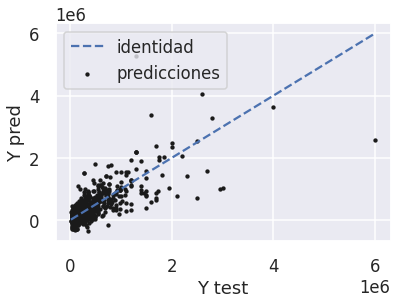

In [33]:
plt.scatter(y_test, pred_test, c = 'k', s = 8, label = 'predicciones')
plt.plot(np.sort(y_test), np.sort(y_test), ls = 'dashed', label = 'identidad')
plt.xlabel('Y test')
plt.ylabel('Y pred')
plt.legend(loc = 'best')
plt.show()

Text(0, 0.5, 'MSE')

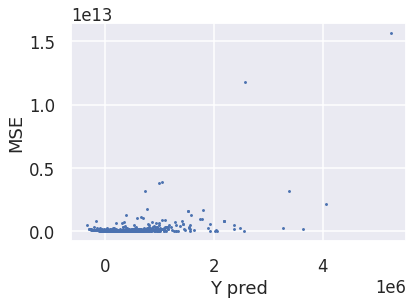

In [34]:
pred_test_l = list(pred_test)
y_test_l = list(y_test)

all_rmse = [mean_squared_error([pred_test_l[i]],[y_test_l[i]]) for i in range(len(pred_test_l))]
plt.scatter(pred_test, all_rmse, s = 2, c = 'b')
plt.xlabel('Y pred')
plt.ylabel('MSE')


## Significancia de las variables.

Entrenamos un regresor multicapa con el conjunto de datos, excluyendo una variable a la vez. Luego observamos la variación en el error obtenido al predecir sobre el conjunto de test. 

In [35]:
loo_columns = list(orig_columns)
loo_columns.remove('barrio')
loo_columns.remove('comuna')
loo_columns.remove('precioUSD')

for col in loo_columns:
  X_loo = X.copy().drop(col, axis = 1)
  X_loo_train, X_loo_test, y_train, y_test = train_test_split(X_loo, y, test_size=test_size, random_state=22)
  
  scaler_X_loo_train = StandardScaler()
  scaler_X_loo_test = StandardScaler()
  scaler_X_loo_train.fit(X_loo_train)
  X_loo_scaled_train = scaler_X_loo_train.transform(X_loo_train)
  scaler_X_loo_test.fit(X_loo_test)
  X_loo_scaled_test = scaler_X_loo_test.transform(X_loo_test)

  model_MLP_scaled_loo = MLPRegressor(random_state=1, max_iter=500)
  model_MLP_scaled_loo.fit(X_loo_scaled_train, y_scaled_train)

  pred_scaled_test  = model_MLP_scaled_loo.predict(X_loo_scaled_test)

  pred_test  = scaler_y_test.inverse_transform(pred_scaled_test.reshape(-1, 1))[:,0]

  print('Al no usar la variable: ', col)
  thisrmse = np.sqrt(mean_squared_error(pred_test, y_test))
  print('Obtenemos Test RMSE:', round(thisrmse, 3))
  origrmse = 275708
  variacionrmse = 100 *(thisrmse - origrmse)/origrmse
  print('El cual representa una variación del', round(variacionrmse, 2), '%')
  print('Respecto al RMSE obtenido con todo el conjunto de datos')
  print('')


Al no usar la variable:  antig
Obtenemos Test RMSE: 381897.8
El cual representa una variación del 38.52 %
Respecto al RMSE obtenido con todo el conjunto de datos

Al no usar la variable:  m2total
Obtenemos Test RMSE: 401181.518
El cual representa una variación del 45.51 %
Respecto al RMSE obtenido con todo el conjunto de datos

Al no usar la variable:  m2cub
Obtenemos Test RMSE: 395254.425
El cual representa una variación del 43.36 %
Respecto al RMSE obtenido con todo el conjunto de datos

Al no usar la variable:  ambientes
Obtenemos Test RMSE: 380015.308
El cual representa una variación del 37.83 %
Respecto al RMSE obtenido con todo el conjunto de datos

Al no usar la variable:  banios
Obtenemos Test RMSE: 388312.126
El cual representa una variación del 40.84 %
Respecto al RMSE obtenido con todo el conjunto de datos

Al no usar la variable:  comisaria_dista
Obtenemos Test RMSE: 384107.539
El cual representa una variación del 39.32 %
Respecto al RMSE obtenido con todo el conjunto de da

Dado que todas las variables resultaron en un aumento del error al ser removidas del dataset, podemos concluir que son todas significativas para la predicción de la variable objetivo.

Observamos que m2total y m2cub son quienes parecen tener mayor significancia, lo cual nos parece razonable dado que el tamaño de un local influye mucho en su precio. Tambien encontramos que count_gastronomia tiene un valor alto de variación en el error al ser removida, lo cual nos indica tambien una alta significancia a la hora de predecir.


# Keras Linear Regression

In [36]:
model_NN = keras.Sequential(
    [
        keras.Input(shape=[X_scaled_train.shape[1]]),
        layers.Dense(77, activation="relu"),
        layers.Dense(77, activation="relu"),
        layers.Dense(1),
    ]
)

model_NN.compile(loss=tf.losses.MeanSquaredError(), optimizer=tf.keras.optimizers.Adam(learning_rate=0.001))

In [37]:
model_NN.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 77)                5775      
                                                                 
 dense_1 (Dense)             (None, 77)                6006      
                                                                 
 dense_2 (Dense)             (None, 1)                 78        
                                                                 
Total params: 11,859
Trainable params: 11,859
Non-trainable params: 0
_________________________________________________________________


In [38]:
history = model_NN.fit(
    X_scaled_train,
    y_scaled_train,
    batch_size=64,
    epochs=1000
)

Epoch 1/1000
47/47 [==============================] - 1s 2ms/step - loss: 0.6990
Epoch 2/1000
47/47 [==============================] - 0s 2ms/step - loss: 0.4312
Epoch 3/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.3967
Epoch 4/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.3636
Epoch 5/1000
47/47 [==============================] - 0s 2ms/step - loss: 0.3379
Epoch 6/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.3427
Epoch 7/1000
47/47 [==============================] - 0s 3ms/step - loss: 0.3304
Epoch 8/1000
47/47 [==============================] - 0s 2ms/step - loss: 0.3195
Epoch 9/1000
47/47 [==============================] - 0s 2ms/step - loss: 0.3043
Epoch 10/1000
47/47 [==============================] - 0s 2ms/step - loss: 0.3022
Epoch 11/1000
47/47 [==============================] - 0s 2ms/step - loss: 0.3056
Epoch 12/1000
47/47 [==============================] - 0s 2ms/step - loss: 0.3070
Epoch 13/1000
47/47 [====

In [39]:
results = model_NN.evaluate(X_scaled_test, y_scaled_test, batch_size=64)

12/12 [==============================] - 0s 2ms/step - loss: 0.5904


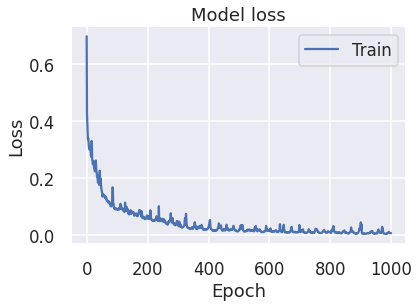

In [40]:
plt.plot(history.history['loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train'], loc='upper right')
plt.show()

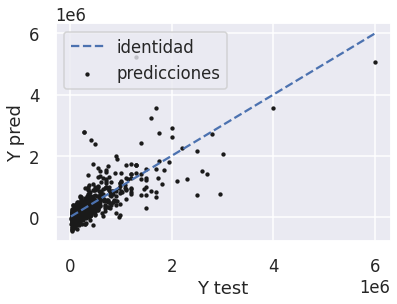

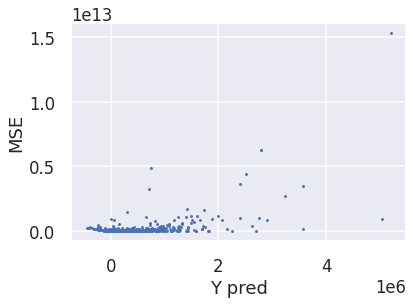

Train RMSE: 269853.00008722686
Test RMSE: 384788.38951232


In [42]:
pred_test_scaled = model_NN.predict(X_scaled_test)

pred_test = scaler_y_test.inverse_transform(pred_test_scaled)

pred_test_l = list(pred_test)
y_test_l = list(y_test)

plt.scatter(y_test, pred_test, c = 'k', s = 8, label = 'predicciones')
plt.plot(np.sort(y_test), np.sort(y_test), ls = 'dashed', label = 'identidad')
plt.xlabel('Y test')
plt.ylabel('Y pred')
plt.legend(loc = 'best')
plt.show()


all_rmse = [mean_squared_error([pred_test_l[i]],[y_test_l[i]]) for i in range(len(pred_test_l))]
plt.scatter(pred_test, all_rmse, s = 2, c = 'b')
plt.xlabel('Y pred')
plt.ylabel('MSE')
plt.show()


print('Train RMSE:', np.sqrt(mean_squared_error(pred_train, y_train)))
print('Test RMSE:', np.sqrt(mean_squared_error(pred_test, y_test)))


## Finalmente buscamos optimizar el modelo mediante la variación de alguno de sus hiperparámetros.

En este caso variaremos también la arquitectura de la red neuronal, junto con la learning rate.

Esperamos encontrar que con una learning rate menor a la usada anteriormente (0.001) obtengamos mejor resultados, ya que al graficar la Loss contra las épocas, vemos un gráfico con muchos picos, lo cual nos indica que la lr podría ser demasiado alta, causando que el descenso por el gradiente de saltos en vez de converger a un mínimo.


In [43]:
def build_model(hp):
    model = keras.Sequential()
    model.add(keras.Input(shape=[X_scaled_train.shape[1]]))
    for i in range(hp.Int('layers', 2, 5)):
        model.add(
            layers.Dense(
                units=hp.Int(
                    'units_' + str(i),
                    min_value=32,
                    max_value=77,
                    step=32
                ),
                activation='relu'
            )
        )
    model.add(layers.Dense(1))
    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', [0.0001, 0.0005, 0.001])),
        loss='mse',
        metrics=['mse'])
    return model

In [48]:
tuner = kt.Hyperband(
    build_model,
    objective='loss',
    max_epochs=20,
    hyperband_iterations=1,
    overwrite=True,
    project_name="houses_prediction",
    directory='/pred'
)

tuner.search(
            X_scaled_train,
            y_scaled_train,
            epochs=10, 
            callbacks=[tf.keras.callbacks.EarlyStopping(patience=20)]
)

Trial 30 Complete [00h 00m 06s]
loss: 0.3483494222164154

Best loss So Far: 0.24163678288459778
Total elapsed time: 00h 01m 50s
INFO:tensorflow:Oracle triggered exit


In [49]:
best_model = tuner.get_best_models(1)[0]
best_hyperparameters = tuner.get_best_hyperparameters(1)[0]

In [50]:
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 64)                4800      
                                                                 
 dense_1 (Dense)             (None, 64)                4160      
                                                                 
 dense_2 (Dense)             (None, 32)                2080      
                                                                 
 dense_3 (Dense)             (None, 64)                2112      
                                                                 
 dense_4 (Dense)             (None, 64)                4160      
                                                                 
 dense_5 (Dense)             (None, 1)                 65        
                                                                 
Total params: 17,377
Trainable params: 17,377
Non-traina

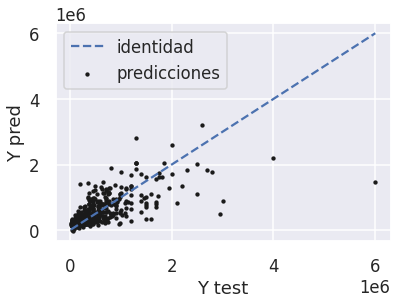

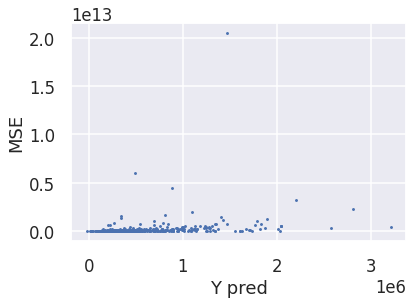

Train RMSE: 269853.00008722686
Test RMSE: 346147.6345739519


In [47]:
pred_test_scaled = best_model.predict(X_scaled_test)

pred_test = scaler_y_test.inverse_transform(pred_test_scaled)

pred_test_l = list(pred_test)
y_test_l = list(y_test)

plt.scatter(y_test, pred_test, c = 'k', s = 8, label = 'predicciones')
plt.plot(np.sort(y_test), np.sort(y_test), ls = 'dashed', label = 'identidad')
plt.xlabel('Y test')
plt.ylabel('Y pred')
plt.legend(loc = 'best')
plt.show()


all_rmse = [mean_squared_error([pred_test_l[i]],[y_test_l[i]]) for i in range(len(pred_test_l))]
plt.scatter(pred_test, all_rmse, s = 2, c = 'b')
plt.xlabel('Y pred')
plt.ylabel('MSE')
plt.show()


print('Train RMSE:', np.sqrt(mean_squared_error(pred_train, y_train)))
print('Test RMSE:', np.sqrt(mean_squared_error(pred_test, y_test)))